# Analysis of raw non-zero suppressed data
### Non-zero suppressed runs: 8088, 8089
### Normal zero suppressed run 7470

In [1]:
from invisible_cities.cities import components as cp
from invisible_cities.reco import calib_sensors_functions as csf
from invisible_cities.database import load_db

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

### Variables to grab runs

In [2]:
num_files = 3
run_number = 7470
num_plots = 3
data_dir = 'data/trigger1/'+str(run_number)+'/'
file_start = 'run_'+str(run_number)+'_000'
file_end = '_trigger1_waveforms.h5'
files = [data_dir+file_start+str(i+1)+file_end for i in range(0,num_files)]

### Print File Format

In [3]:
i = 0
wfs = cp.wf_from_files(files, cp.WfType.rwf)
try:
    while wfs and i < 1:
        thisdata = next(wfs)
        keys = thisdata.keys()
        print('Keys:', keys)
        for key in keys:
            print(key, type(thisdata[key]))
            print('    ', np.shape(thisdata[key]))
            print('              ', thisdata[key])
        i += 1
except StopIteration:
    pass
finally:
    del wfs

Keys: dict_keys(['pmt', 'sipm', 'run_number', 'event_number', 'timestamp', 'trigger_type', 'trigger_channels'])
pmt <class 'numpy.ndarray'>
     (12, 52000)
               [[3142 3142 3142 ... 3143 3143 3143]
 [3166 3166 3166 ... 3165 3163 3164]
 [3147 3146 3147 ... 3146 3145 3146]
 ...
 [3157 3156 3157 ... 3158 3158 3156]
 [3197 3198 3198 ... 3198 3198 3197]
 [3177 3176 3177 ... 3174 3175 3175]]
sipm <class 'numpy.ndarray'>
     (1792, 1300)
               [[ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ... 55 49 52]
 ...
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]]
run_number <class 'numpy.int32'>
     ()
               7470
event_number <class 'numpy.int32'>
     ()
               839
timestamp <class 'numpy.uint64'>
     ()
               1566498751809
trigger_type <class 'numpy.int32'>
     ()
               1
trigger_channels <class 'numpy.ndarray'>
     (12,)
               [1 0 1 0 0 0 0 0 0 0 0 0]


### Collect data into numpy array

In [4]:
i = 0
events = []
wfs = cp.wf_from_files(files, cp.WfType.rwf)
try:
    while wfs and i < 100:
        thisdata = next(wfs)
        events.append(thisdata['sipm'])
        i += 1
except StopIteration:
    pass
finally:
    del wfs
events = np.array(events)
print('Number of Events: '+str(len(events)))

Number of Events: 100


In [5]:
i = 0
pmt_events = []
wfs = cp.wf_from_files(files, cp.WfType.rwf)
try:
    while wfs:
        thisdata = next(wfs)
        pmt_events.append(thisdata['pmt'])
        i += 1
except StopIteration:
    pass
finally:
    del wfs
pmt_events = np.array(pmt_events)
print('Number of Events: '+str(len(pmt_events)))

Number of Events: 2329


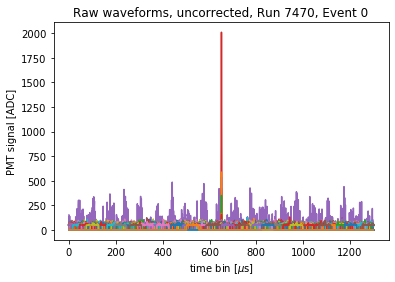

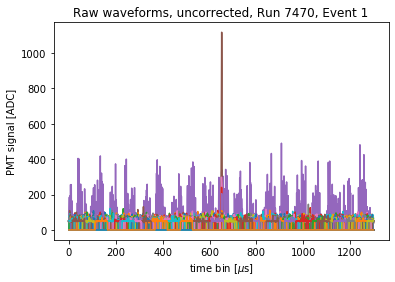

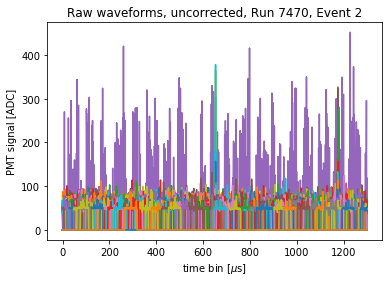

In [6]:

for event in range(0,num_plots):
    summed_sipms = np.sum(pmt_events[event], axis=1)
    for pmt in events[event]:
        plt.plot(pmt)
    plt.xlabel(r'time bin [$\mu$s]')
    plt.ylabel('PMT signal [ADC]')
    plt.title('Raw waveforms, uncorrected, Run '+str(run_number)+', Event '+str(event))
    #plt.xlim(640,660)
    #plt.ylim(60000,100000)
    plt.show()

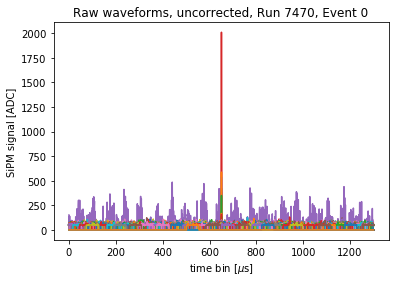

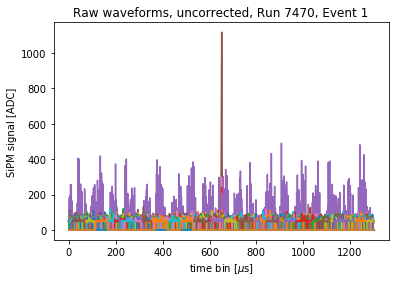

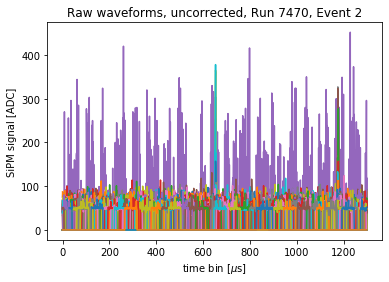

In [7]:
# Plotting a few raw waveforms, without any corrections
for event in range(0,num_plots):
    summed_sipms = np.sum(events[event], axis=1)
    for sipm in events[event]:
        plt.plot(sipm)
    plt.xlabel(r'time bin [$\mu$s]')
    plt.ylabel('SiPM signal [ADC]')
    plt.title('Raw waveforms, uncorrected, Run '+str(run_number)+', Event '+str(event))
    #plt.xlim(640,660)
    #plt.ylim(60000,100000)
    plt.show()

### Finding the noisy SiPMs

In [8]:
pedestals = np.mean(events, axis=2) # shape: (events, sipms)
event_std = np.std(events, axis=2) # shape: (events, sipms)

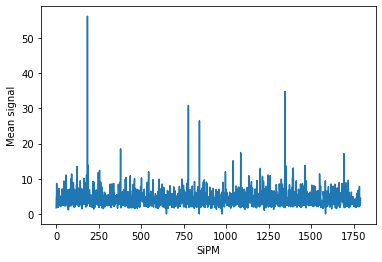

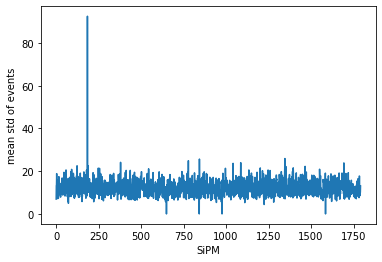

In [9]:
plt.plot(np.mean(pedestals, axis=0))
plt.xlabel('SiPM')
plt.ylabel('Mean signal')
plt.show()

plt.plot(np.mean(event_std, axis=0))
plt.xlabel('SiPM')
plt.ylabel('mean std of events')
plt.show()

In [5]:
bad_sipms = []
for event in range(0,len(events)):
    for sipm in range(len(events[event])):
        mean = np.mean(events[event][sipm])
        std = np.std(events[event][sipm])
        if mean > 70 or std > 70:
            bad_sipms.append(sipm)

worst_sipms = []
for sipm in np.unique(bad_sipms):
    count = np.count_nonzero(bad_sipms == sipm)
    print('SiPM '+str(sipm)+' suspicious in '+str(count)+' events')
    if count == len(events):
        worst_sipms.append(sipm)
print(worst_sipms)

SiPM 9 suspicious in 1 events
SiPM 16 suspicious in 1 events
SiPM 17 suspicious in 1 events
SiPM 184 suspicious in 100 events
SiPM 399 suspicious in 1 events
SiPM 404 suspicious in 1 events
SiPM 440 suspicious in 1 events
SiPM 1001 suspicious in 1 events
SiPM 1009 suspicious in 1 events
SiPM 1120 suspicious in 1 events
SiPM 1128 suspicious in 1 events
SiPM 1506 suspicious in 1 events
SiPM 1507 suspicious in 1 events
SiPM 1563 suspicious in 1 events
[184]


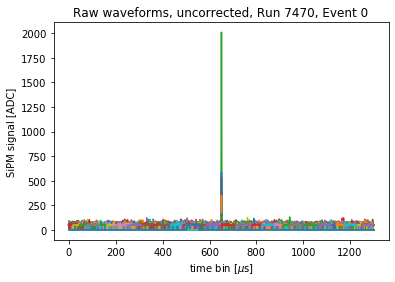

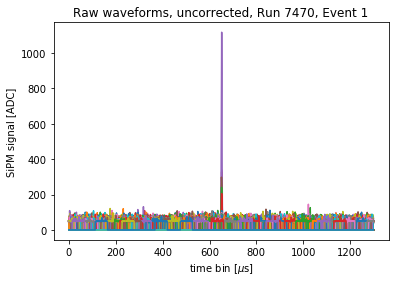

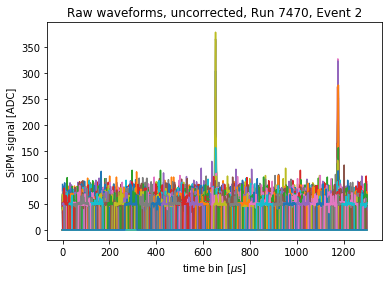

In [11]:
# Plotting a few raw waveforms, without any corrections
for event in range(0,num_plots):
    for sipm in range(len(events[event])):
        if sipm not in worst_sipms:
            plt.plot(events[event][sipm])
    plt.xlabel(r'time bin [$\mu$s]')
    plt.ylabel('SiPM signal [ADC]')
    plt.title('Raw waveforms, uncorrected, Run '+str(run_number)+', Event '+str(event))
    #plt.xlim(640,660)
    #plt.ylim(60000,100000)
    plt.show()

### Calibrate: remove pedestal and convert to pes

In [6]:
sipm_thr = 0
detector_db = 'new'
cal_sipms = cp.calibrate_sipms(detector_db, run_number, sipm_thr)
calibrated_sipms = np.array([cal_sipms(wfs) for wfs in events]) 

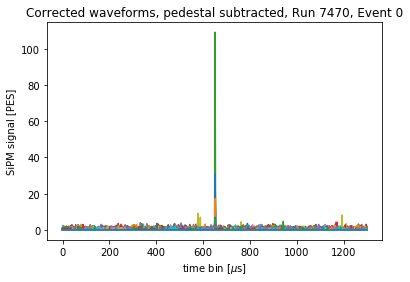

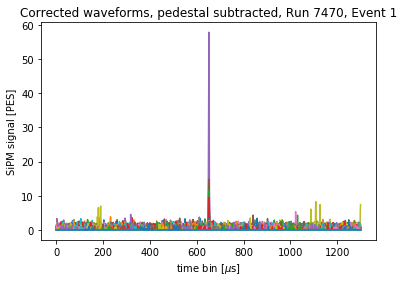

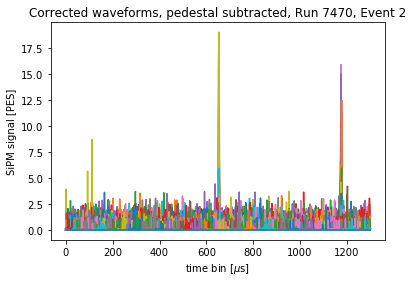

In [31]:
# Plotting a few waveforms, pedestal subtracted, calibrated
for event in range(0,num_plots):
    for sipm in range(len(calibrated_sipms[event])):
        if sipm not in worst_sipms:
            plt.plot(calibrated_sipms[event][sipm])
    plt.xlabel(r'time bin [$\mu$s]')
    plt.ylabel('SiPM signal [PES]')
    plt.title('Corrected waveforms, pedestal subtracted, Run '+str(run_number)+', Event '+str(event))
    #plt.xlim(640,660)
    #plt.ylim(60000,100000)
    plt.show()

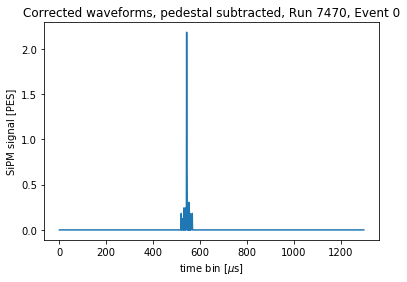

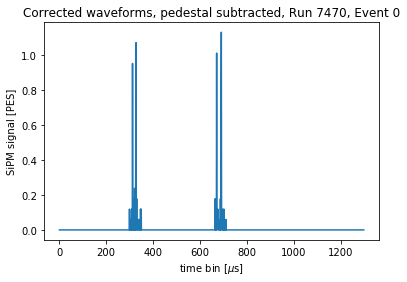

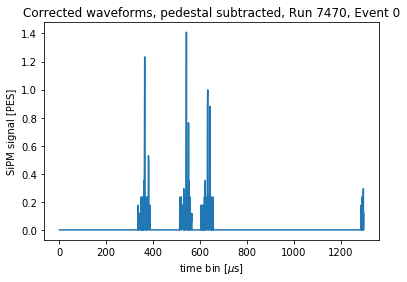

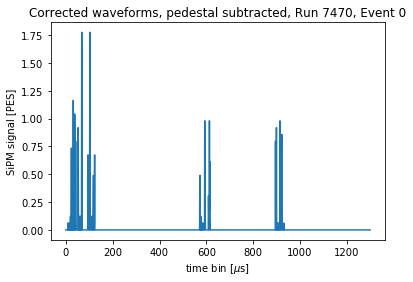

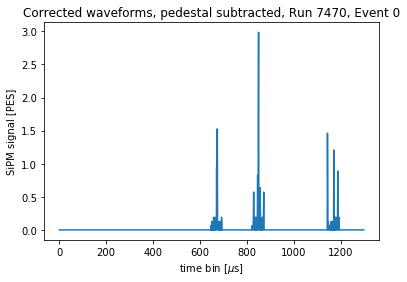

...

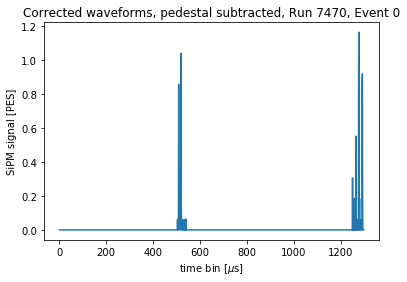

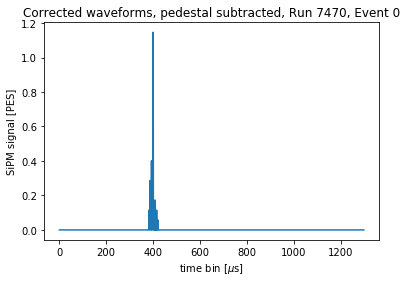

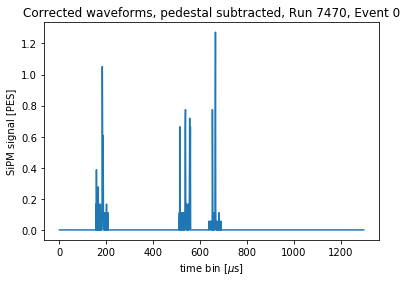

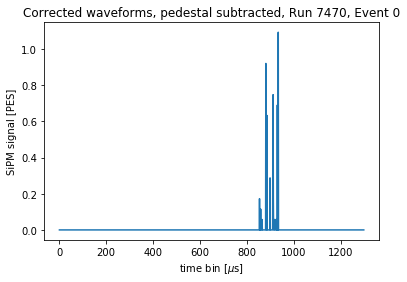

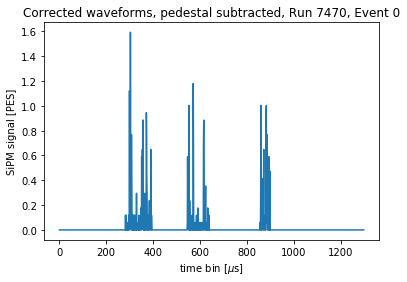

KeyboardInterrupt: 

In [36]:
event = 0
for sipm in range(len(calibrated_sipms[event])):
    if sipm not in worst_sipms:
        plt.plot(calibrated_sipms[event][sipm])
        plt.xlabel(r'time bin [$\mu$s]')
        plt.ylabel('SiPM signal [PES]')
        plt.title('Corrected waveforms, pedestal subtracted, Run '+str(run_number)+', Event '+str(event))
        #plt.xlim(640,660)
        #plt.ylim(60000,100000)
        plt.show()

### Find average waveform

In [7]:
signal_good_sipms = pd.DataFrame(columns=['event','sipm', 'maxcharge'])

In [8]:
signal_good_sipms

,event,sipm,maxcharge


In [10]:
for event in range(0,100): #len(calibrated_sipms[200])):
    for sipm in range(len(calibrated_sipms[event])):
        if sipm not in worst_sipms:
            this_sipm = pd.DataFrame([[event, sipm, np.max(calibrated_sipms[event][sipm])]],
                                     columns=['event','sipm', 'maxcharge'])
            signal_good_sipms = signal_good_sipms.append(this_sipm)

In [20]:
int_sipms = np.sum(calibrated_sipms, axis=2)
int_sipms = np.delete(int_sipms, worst_sipms, axis=1)

In [21]:
int_events = np.sum(int_sipms, axis=1)

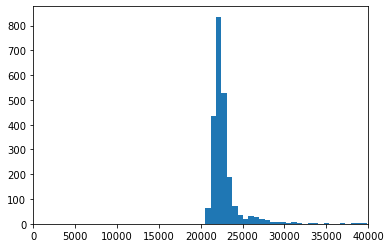

In [22]:
plt.hist(int_events, bins=100)
plt.xlim(0,40000)
plt.show()

Text(0.5, 1.0, 'Run 7470')

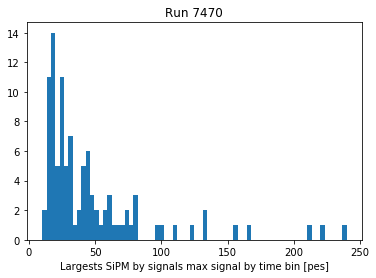

In [11]:
plt.hist(signal_good_sipms.groupby('event').agg({'maxcharge':'max'}).maxcharge, bins=70)
plt.xlabel('Largests SiPM by signals max signal by time bin [pes]')
plt.title('Run '+str(run_number))
#plt.xlim(0,25)

In [39]:
signal_good_sipms.maxcharge.std

<bound method Series.std of 0    2.182268
0    1.128179
0    1.408939
0    1.775992
0    2.985757
       ...   
0    0.000000
0    1.099391
0    0.000000
0    1.587651
0    1.979045
Name: maxcharge, Length: 358200, dtype: float64>

In [25]:
np.shape(signal_good_sipms)

(358200, 3)

In [26]:
max_signal = np.max(np.max(calibrated_sipms, axis=2), axis=1)

In [27]:
import pandas as pd

In [28]:
sipm_signal = pd.DataFrame({'max charge':})

SyntaxError: invalid syntax (<ipython-input-28-e9be5c7e8782>, line 1)

In [ ]:
for sipm in range(len(max_signal)):
        if sipm not in worst_sipms:
            plt.plot(max_signal[sipm])

In [ ]:
np.shape(max_signal)